# Exploratory Data Analysis on Electric Vehicle Dataset

In [1]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns

from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = 'all'

import warnings
warnings.filterwarnings('ignore')

In [2]:
electric_vehicle = pd.read_csv(r"C:\Users\FHANI\OneDrive\Desktop\Innomatics-Data Science\Internship\EDA_Electric_Vehicle\dataset.csv")

In [3]:
electric_vehicle.head()
electric_vehicle.info()

,VIN (1-10),County,City,State,Postal Code,Model Year,Make,Model,Electric Vehicle Type,Clean Alternative Fuel Vehicle (CAFV) Eligibility,Electric Range,Base MSRP,Legislative District,DOL Vehicle ID,Vehicle Location,Electric Utility,2020 Census Tract
0,JTMEB3FV6N,Monroe,Key West,FL,33040,2022,TOYOTA,RAV4 PRIME,Plug-in Hybrid Electric Vehicle (PHEV),Clean Alternative Fuel Vehicle Eligible,42,0,NaN,198968248,POINT (-81.80023 24.5545),NaN,12087972100
1,1G1RD6E45D,Clark,Laughlin,NV,89029,2013,CHEVROLET,VOLT,Plug-in Hybrid Electric Vehicle (PHEV),Clean Alternative Fuel Vehicle Eligible,38,0,NaN,5204412,POINT (-114.57245 35.16815),NaN,32003005702
2,JN1AZ0CP8B,Yakima,Yakima,WA,98901,2011,NISSAN,LEAF,Battery Electric Vehicle (BEV),Clean Alternative Fuel Vehicle Eligible,73,0,15.0,218972519,POINT (-120.50721 46.60448),PACIFICORP,53077001602
3,1G1FW6S08H,Skagit,Concrete,WA,98237,2017,CHEVROLET,BOLT EV,Battery Electric Vehicle (BEV),Clean Alternative Fuel Vehicle Eligible,238,0,39.0,186750406,POINT (-121.7515 48.53892),PUGET SOUND ENERGY INC,53057951101
4,3FA6P0SU1K,Snohomish,Everett,WA,98201,2019,FORD,FUSION,Plug-in Hybrid Electric Vehicle (PHEV),Not eligible due to low battery range,26,0,38.0,2006714,POINT (-122.20596 47.97659),PUGET SOUND ENERGY INC,53061041500


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 112634 entries, 0 to 112633
Data columns (total 17 columns):
 #   Column                                             Non-Null Count   Dtype  
---  ------                                             --------------   -----  
 0   VIN (1-10)                                         112634 non-null  object 
 1   County                                             112634 non-null  object 
 2   City                                               112634 non-null  object 
 3   State                                              112634 non-null  object 
 4   Postal Code                                        112634 non-null  int64  
 5   Model Year                                         112634 non-null  int64  
 6   Make                                               112634 non-null  object 
 7   Model                                              112614 non-null  object 
 8   Electric Vehicle Type                              112634 non-null  object

### Fixing Column names

In [4]:
electric_vehicle.columns

Index(['VIN (1-10)', 'County', 'City', 'State', 'Postal Code', 'Model Year',
       'Make', 'Model', 'Electric Vehicle Type',
       'Clean Alternative Fuel Vehicle (CAFV) Eligibility', 'Electric Range',
       'Base MSRP', 'Legislative District', 'DOL Vehicle ID',
       'Vehicle Location', 'Electric Utility', '2020 Census Tract'],
      dtype='object')

In [17]:
electric_vehicle.columns = electric_vehicle.columns.str.replace("_(CAFV)","")
electric_vehicle.columns = electric_vehicle.columns.str.replace("(1-10)","one_to_ten")
electric_vehicle.columns = electric_vehicle.columns.str.replace("\"2020\"_Census_Tract","Census_Tract_2020")


In [18]:
electric_vehicle.columns

Index(['VIN_one_to_ten', 'County', 'City', 'State', 'Postal_Code',
       'Model_Year', 'Make', 'Model', 'Electric_Vehicle_Type',
       'Clean_Alternative_Fuel_Vehicle_Eligibility', 'Electric_Range',
       'Base_MSRP', 'Legislative_District', 'DOL_Vehicle_ID',
       'Vehicle_Location', 'Electric_Utility', 'Census_Tract_2020'],
      dtype='object')

In [159]:
electric_vehicle.head()

,VIN_one_to_ten,County,City,State,Postal_Code,Model_Year,Make,Model,Electric_Vehicle_Type,Clean_Alternative_Fuel_Vehicle_Eligibility,Electric_Range,Base_MSRP,Legislative_District,DOL_Vehicle_ID,Vehicle_Location,Electric_Utility,Census_Tract_2020
0,JTMEB3FV6N,Monroe,Key West,FL,33040,2022,TOYOTA,RAV4 PRIME,Plug-in Hybrid Electric Vehicle (PHEV),Clean Alternative Fuel Vehicle Eligible,42,0,NaN,198968248,POINT (-81.80023 24.5545),NaN,12087972100
1,1G1RD6E45D,Clark,Laughlin,NV,89029,2013,CHEVROLET,VOLT,Plug-in Hybrid Electric Vehicle (PHEV),Clean Alternative Fuel Vehicle Eligible,38,0,NaN,5204412,POINT (-114.57245 35.16815),NaN,32003005702
2,JN1AZ0CP8B,Yakima,Yakima,WA,98901,2011,NISSAN,LEAF,Battery Electric Vehicle (BEV),Clean Alternative Fuel Vehicle Eligible,73,0,15.0,218972519,POINT (-120.50721 46.60448),PACIFICORP,53077001602
3,1G1FW6S08H,Skagit,Concrete,WA,98237,2017,CHEVROLET,BOLT EV,Battery Electric Vehicle (BEV),Clean Alternative Fuel Vehicle Eligible,238,0,39.0,186750406,POINT (-121.7515 48.53892),PUGET SOUND ENERGY INC,53057951101
4,3FA6P0SU1K,Snohomish,Everett,WA,98201,2019,FORD,FUSION,Plug-in Hybrid Electric Vehicle (PHEV),Not eligible due to low battery range,26,0,38.0,2006714,POINT (-122.20596 47.97659),PUGET SOUND ENERGY INC,53061041500


### Check for Duplicates

In [7]:
electric_vehicle.duplicated().sum()

0

#### No duplicates are present in the dataset

### Check for Missing values

In [83]:
electric_vehicle.isna().sum()

VIN_one_to_ten                                  0
County                                          0
City                                            0
State                                           0
Postal_Code                                     0
Model_Year                                      0
Make                                            0
Model                                          20
Electric_Vehicle_Type                           0
Clean_Alternative_Fuel_Vehicle_Eligibility      0
Electric_Range                                  0
Base_MSRP                                       0
Legislative_District                          286
DOL_Vehicle_ID                                  0
Vehicle_Location                               24
Electric_Utility                              443
Census_Tract_2020                               0
dtype: int64

In [84]:
(((electric_vehicle.isna().sum().sort_values(ascending = False))/len(electric_vehicle))*100).astype(str) + "%"

Electric_Utility                                0.3933093026972317%
Legislative_District                           0.25391977555622636%
Vehicle_Location                              0.021307953193529485%
Model                                          0.01775662766127457%
VIN_one_to_ten                                                 0.0%
Clean_Alternative_Fuel_Vehicle_Eligibility                     0.0%
DOL_Vehicle_ID                                                 0.0%
Base_MSRP                                                      0.0%
Electric_Range                                                 0.0%
Electric_Vehicle_Type                                          0.0%
County                                                         0.0%
Make                                                           0.0%
Model_Year                                                     0.0%
Postal_Code                                                    0.0%
State                                           

### Check for Empty Strings

In [85]:
electric_vehicle.eq("").sum()

VIN_one_to_ten                                0
County                                        0
City                                          0
State                                         0
Postal_Code                                   0
Model_Year                                    0
Make                                          0
Model                                         0
Electric_Vehicle_Type                         0
Clean_Alternative_Fuel_Vehicle_Eligibility    0
Electric_Range                                0
Base_MSRP                                     0
Legislative_District                          0
DOL_Vehicle_ID                                0
Vehicle_Location                              0
Electric_Utility                              0
Census_Tract_2020                             0
dtype: int64

## Task_1 : Univariate and Bivariate Analysis

### Univariate Analysis

In [161]:
electric_vehicle.select_dtypes(include="number").columns

Index(['Postal_Code', 'Model_Year', 'Electric_Range', 'Base_MSRP',
       'Legislative_District', 'DOL_Vehicle_ID', 'Census_Tract_2020'],
      dtype='object')

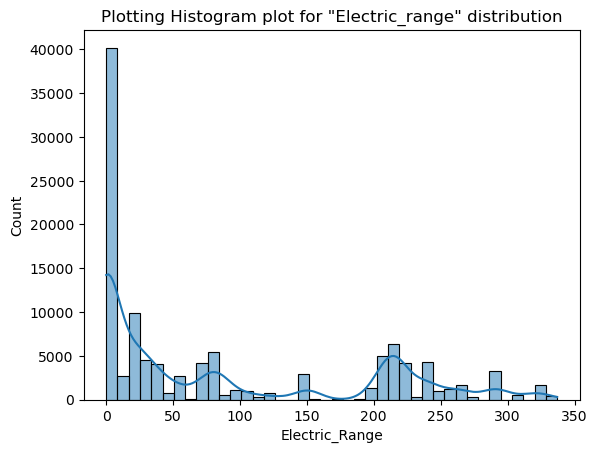

In [167]:
plt.title("Plotting Histogram plot for \"Electric_range\" distribution")
sns.histplot(data = electric_vehicle,x = 'Electric_Range',kde = True)
plt.show();

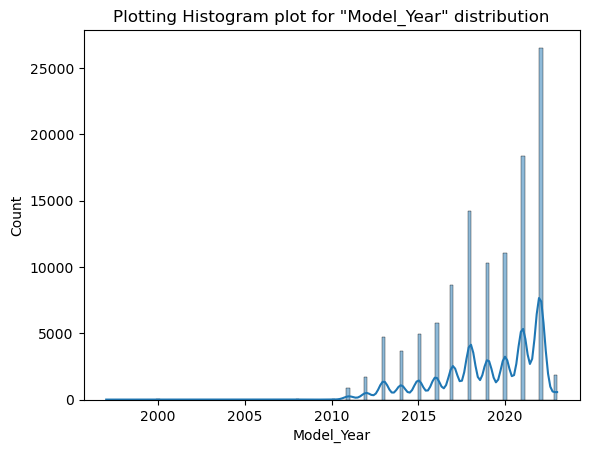

In [170]:
plt.title("Plotting Histogram plot for \"Model_Year\" distribution")
sns.histplot(data = electric_vehicle,x = 'Model_Year',kde = True)
plt.show();

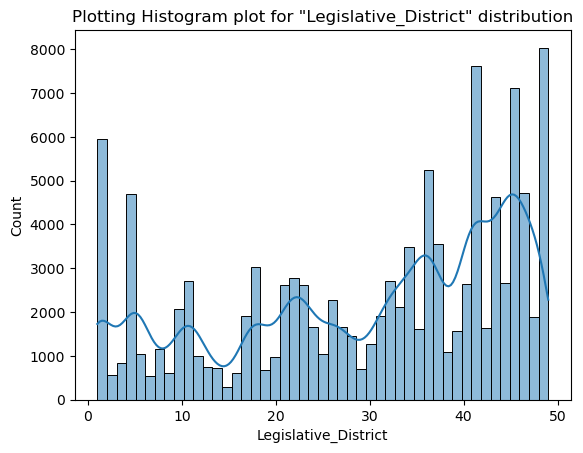

In [174]:
plt.title("Plotting Histogram plot for \"Legislative_District\" distribution")
sns.histplot(data = electric_vehicle,x = 'Legislative_District',kde = True)
plt.show();

In [177]:
electric_vehicle.select_dtypes(include="object").columns

Index(['VIN_one_to_ten', 'County', 'City', 'State', 'Make', 'Model',
       'Electric_Vehicle_Type', 'Clean_Alternative_Fuel_Vehicle_Eligibility',
       'Vehicle_Location', 'Electric_Utility'],
      dtype='object')

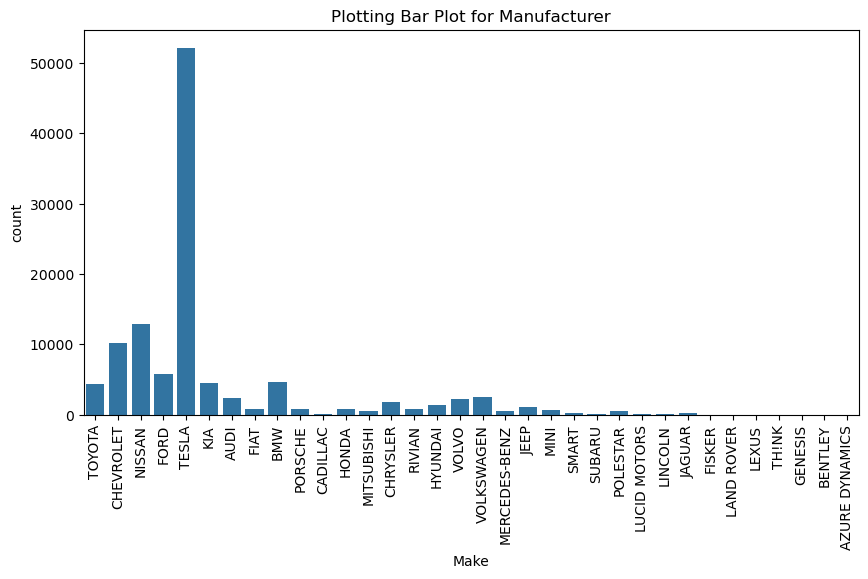

In [185]:
plt.figure(figsize = (10,5))
plt.title("Plotting Bar Plot for Manufacturer")
sns.countplot(data = electric_vehicle,x = "Make")
plt.xticks(rotation = 90)
plt.show();

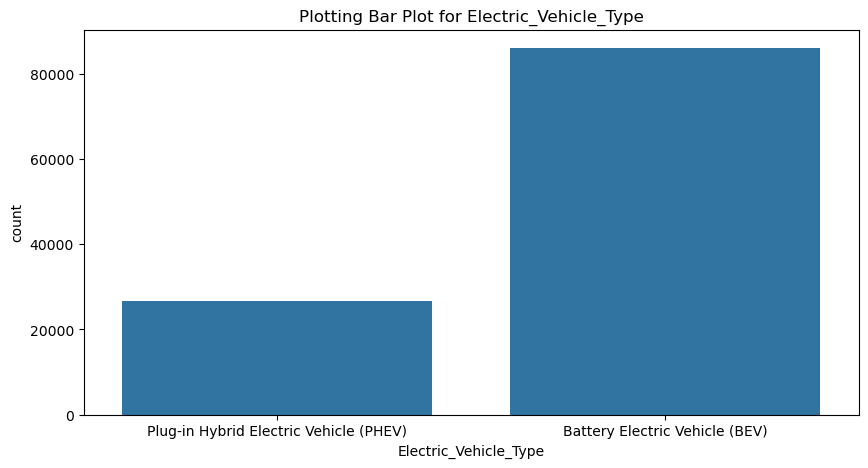

In [187]:
plt.figure(figsize = (10,5))
plt.title("Plotting Bar Plot for Electric_Vehicle_Type")
sns.countplot(data = electric_vehicle,x = "Electric_Vehicle_Type")

plt.show();

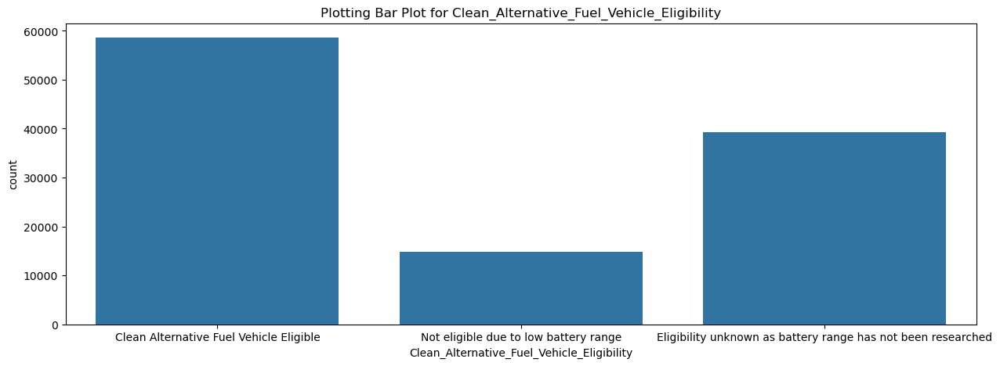

In [190]:
plt.figure(figsize = (15,5))
plt.title("Plotting Bar Plot for Clean_Alternative_Fuel_Vehicle_Eligibility")
sns.countplot(data = electric_vehicle,x = "Clean_Alternative_Fuel_Vehicle_Eligibility")

plt.show();

## Observations
1. Excluding the vehicle which are having "0" electric range in the data set, most of the vehicles can able to travel up 200 to 250 km and upto 50 km.
2. Around 27000 number of cars were manufactured by different companies with different models on the year 2022 ,which is the highest number over all years in the data set.
3. Around 8000 people resides in Legislative district having section "49", which is the highest count among all the sections of Legislative district.
4. Tesla has manufactured more number of electric vehicles(>50000),which is the highest among all the manufacturers.
5. Around 85000 electric vehicles in the data set are of "BEV" Electric vehicle Type.
6. Around 25000 electric vehicles in the data set are of "PHEV" Electric vehicle Type.
7. Nearly 60000 electric vehicles are CAFV eligible vehicles

### Bivariate Analysis

#### Numerical vs Numerical Variables

In [195]:
electric_vehicle.select_dtypes(include="number").columns

Index(['Postal_Code', 'Model_Year', 'Electric_Range', 'Base_MSRP',
       'Legislative_District', 'DOL_Vehicle_ID', 'Census_Tract_2020'],
      dtype='object')

<Axes: xlabel='Base_MSRP', ylabel='Electric_Range'>

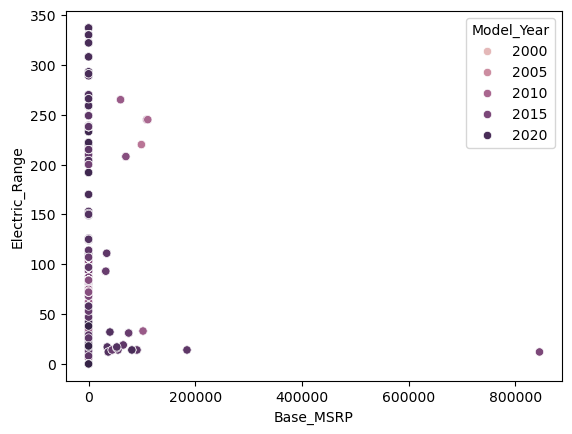

In [200]:
sns.scatterplot(data=electric_vehicle,x = "Base_MSRP",y = "Electric_Range",hue = "Model_Year")

<Axes: xlabel='Electric_Range', ylabel='Model_Year'>

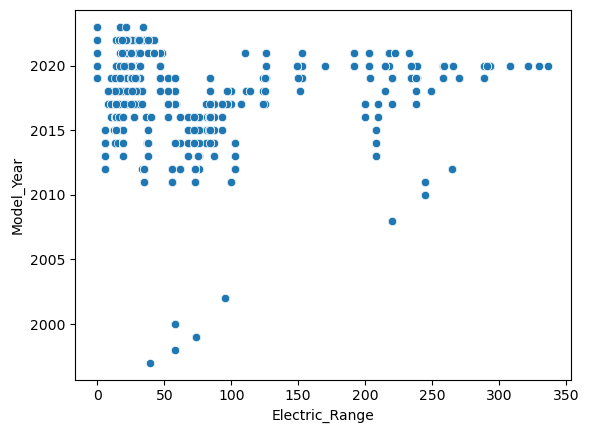

In [203]:
sns.scatterplot(data=electric_vehicle,x = "Electric_Range",y = "Model_Year")

#### Numerical vs Categorical Variables

In [205]:
electric_vehicle.select_dtypes(include="number").columns

Index(['Postal_Code', 'Model_Year', 'Electric_Range', 'Base_MSRP',
       'Legislative_District', 'DOL_Vehicle_ID', 'Census_Tract_2020'],
      dtype='object')

In [204]:
electric_vehicle.select_dtypes(include="object").columns

Index(['VIN_one_to_ten', 'County', 'City', 'State', 'Make', 'Model',
       'Electric_Vehicle_Type', 'Clean_Alternative_Fuel_Vehicle_Eligibility',
       'Vehicle_Location', 'Electric_Utility'],
      dtype='object')

1. Electric_Range vs Make
2. Electric_Vehicle_Type vs Electric_Range
3. Clean_Alternative_Fuel_Vehicle_Eligibility vs Electric_Range

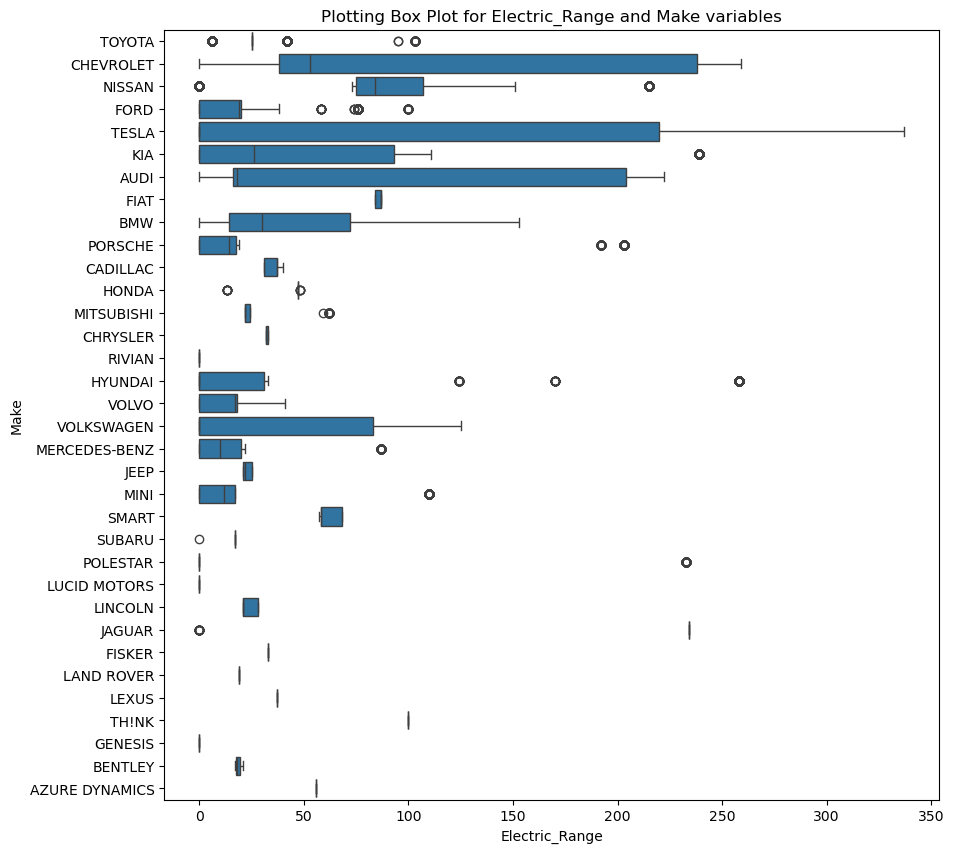

In [213]:
plt.figure(figsize=(10,10))
plt.title("Plotting Box Plot for Electric_Range and Make variables")
sns.boxplot(data=electric_vehicle,x = "Electric_Range", y = "Make")
plt.show();

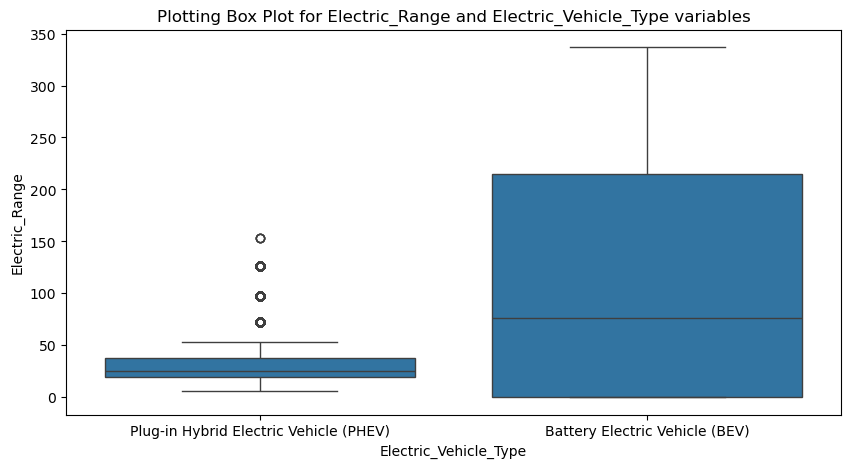

In [215]:
plt.figure(figsize=(10,5))
plt.title("Plotting Box Plot for Electric_Range and Electric_Vehicle_Type variables")
sns.boxplot(data=electric_vehicle,x = "Electric_Vehicle_Type", y = "Electric_Range")
plt.show();

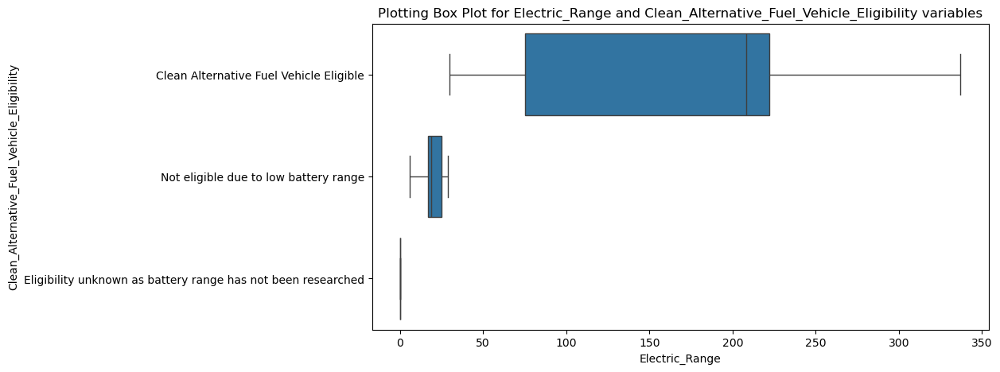

In [217]:
plt.figure(figsize=(10,5))
plt.title("Plotting Box Plot for Electric_Range and Clean_Alternative_Fuel_Vehicle_Eligibility variables")
sns.boxplot(data=electric_vehicle,x = "Electric_Range", y = "Clean_Alternative_Fuel_Vehicle_Eligibility")
plt.show();

#### Categorical vs Categorical Variables

In [218]:
electric_vehicle.select_dtypes(include="object").columns

Index(['VIN_one_to_ten', 'County', 'City', 'State', 'Make', 'Model',
       'Electric_Vehicle_Type', 'Clean_Alternative_Fuel_Vehicle_Eligibility',
       'Vehicle_Location', 'Electric_Utility'],
      dtype='object')

1. Electric_Vehicle_Type vs Clean_Alternative_Fuel_Vehicle_Eligibility
2. Electric_Vehicle_Type vs Make
3. Clean_Alternative_Fuel_Vehicle_Eligibility vs Make

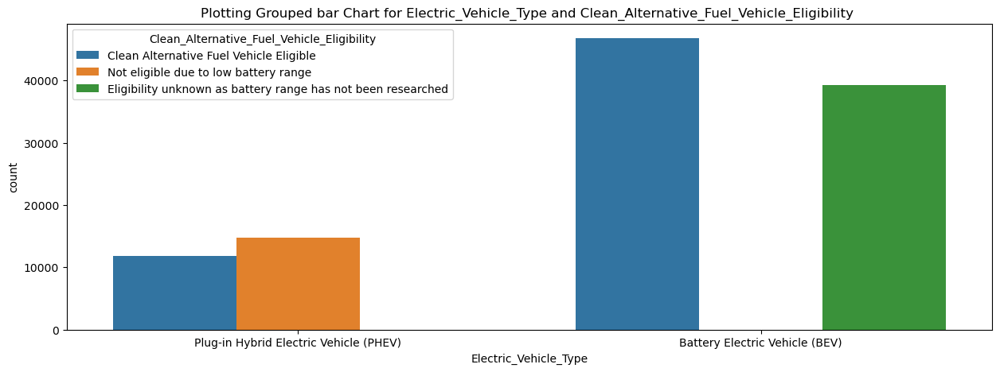

In [229]:
plt.figure(figsize = (15,5))
plt.title("Plotting Grouped bar Chart for Electric_Vehicle_Type and Clean_Alternative_Fuel_Vehicle_Eligibility ")
sns.countplot(data = electric_vehicle,x = "Electric_Vehicle_Type", hue = "Clean_Alternative_Fuel_Vehicle_Eligibility")
plt.show();

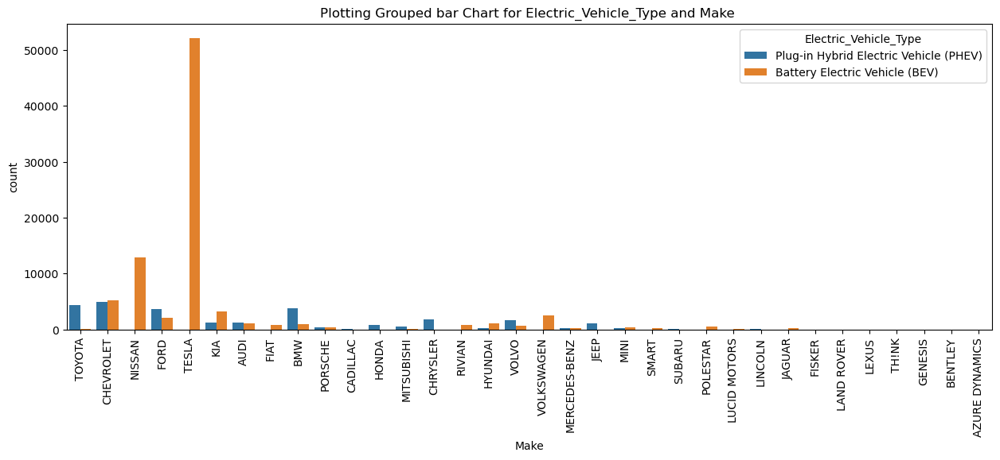

In [232]:
plt.figure(figsize = (15,5))
plt.title("Plotting Grouped bar Chart for Electric_Vehicle_Type and Make ")
sns.countplot(data = electric_vehicle,x = "Make", hue = "Electric_Vehicle_Type")
plt.xticks(rotation = 90)
plt.show();

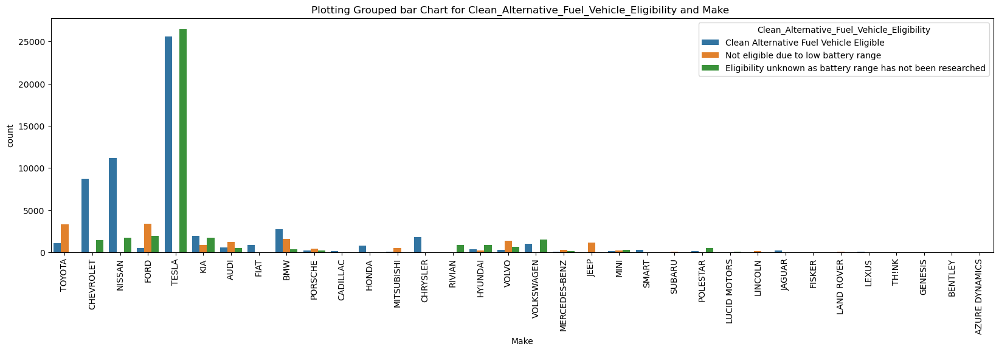

In [234]:
plt.figure(figsize = (20,5))
plt.title("Plotting Grouped bar Chart for Clean_Alternative_Fuel_Vehicle_Eligibility and Make ")
sns.countplot(data = electric_vehicle,x = "Make", hue = "Clean_Alternative_Fuel_Vehicle_Eligibility")
plt.xticks(rotation = 90)
plt.show();

## Task_2 : Creating a Choropleth using plotly.express

In [157]:
ev_count_by_states = electric_vehicle.groupby('State')["VIN_one_to_ten"].count().reset_index(name = "EV_Count")

In [22]:
import plotly.express as px

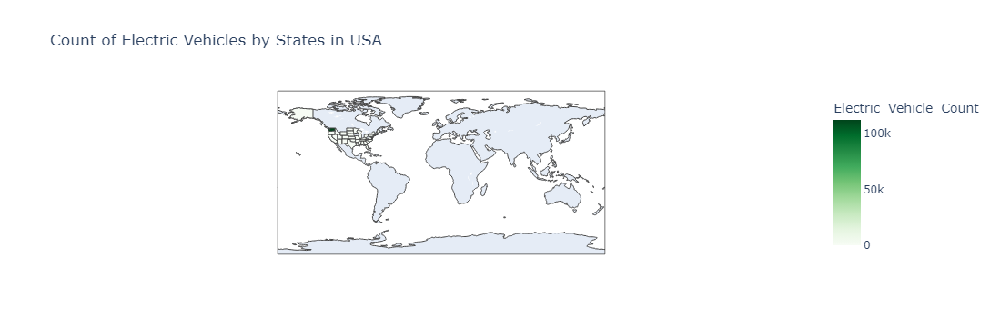

In [158]:
fig = px.choropleth(ev_count_by_states,
    locations = "State",
    locationmode='USA-states',
    color="EV_Count",
    color_continuous_scale='Greens',
                    scope='world',
    labels={"EV_Count":'Electric_Vehicle_Count'},
    title="Count of Electric Vehicles by States in USA")
fig.show()

## Task_3 : Creating a Racing Bar Plot to display the animation of EV Make and its count each year.


In [131]:
!pip install bar-chart-race

   ---------------------------------------- 0.0/156.8 kB ? eta -:--:--
   -- ------------------------------------- 10.2/156.8 kB ? eta -:--:--
   -- ------------------------------------- 10.2/156.8 kB ? eta -:--:--
   ------- ------------------------------- 30.7/156.8 kB 262.6 kB/s eta 0:00:01
   --------------- ----------------------- 61.4/156.8 kB 363.1 kB/s eta 0:00:01
   ----------------- --------------------- 71.7/156.8 kB 393.8 kB/s eta 0:00:01
   ----------------- --------------------- 71.7/156.8 kB 393.8 kB/s eta 0:00:01
   ----------------- --------------------- 71.7/156.8 kB 393.8 kB/s eta 0:00:01
   ----------------- --------------------- 71.7/156.8 kB 393.8 kB/s eta 0:00:01
   ----------------- --------------------- 71.7/156.8 kB 393.8 kB/s eta 0:00:01
   -------------------------------------- 156.8/156.8 kB 361.0 kB/s eta 0:00:00


In [132]:
import bar_chart_race as bcr

In [141]:
df3 = electric_vehicle.groupby(['Model_Year','Make']).size().unstack(fill_value=0)

In [143]:
df3

Make,AUDI,AZURE DYNAMICS,BENTLEY,BMW,CADILLAC,CHEVROLET,CHRYSLER,FIAT,FISKER,FORD,...,POLESTAR,PORSCHE,RIVIAN,SMART,SUBARU,TESLA,TH!NK,TOYOTA,VOLKSWAGEN,VOLVO
Model_Year,,,,,,,,,,,,,,,,,,,,,
1997,0,0,0,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1998,0,0,0,0,0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0
1999,0,0,0,0,0,0,0,0,0,3,...,0,0,0,0,0,0,0,0,0,0
2000,0,0,0,0,0,0,0,0,0,10,...,0,0,0,0,0,0,0,0,0,0
2002,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,2,0,0
2008,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,23,0,0,0,0
2010,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,24,0,0,0,0
2011,0,4,0,0,0,71,0,0,0,0,...,0,0,0,0,0,7,3,0,0,0
2012,0,3,0,0,0,496,0,0,20,15,...,0,0,0,0,0,134,0,385,0,0


In [155]:
bcr.bar_chart_race(
    df=df3,
    filename = 'Racing_Bar_Plot.gif',
    title = 'Electric Vehicles Count by Manufacturer Over Years',
    filter_column_colors=True,
    sort='desc',
    n_bars=10,
    steps_per_period = 45,
    figsize=(10,6),
    title_size=10,
    bar_label_size=10,
    period_length=3000,
)

MovieWriter imagemagick unavailable; using Pillow instead.


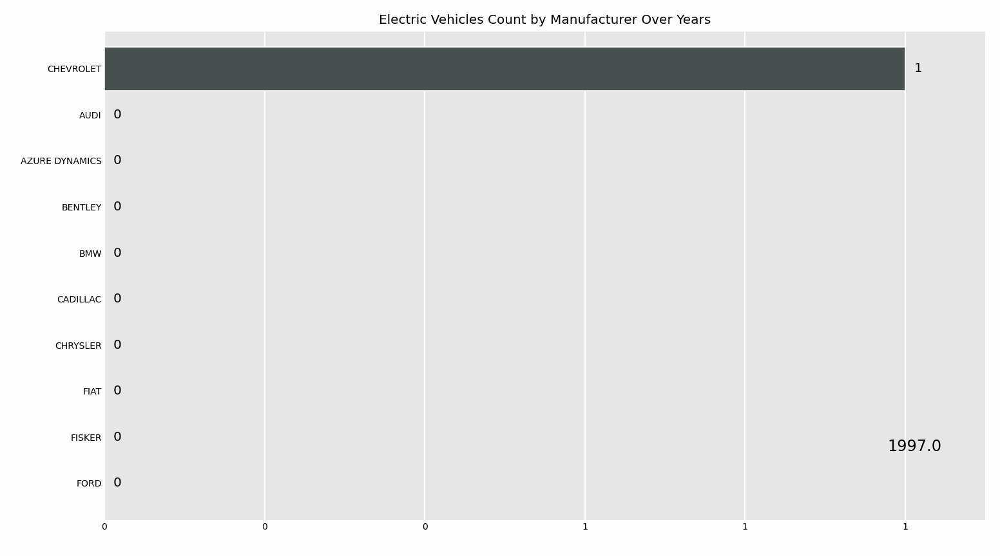

In [156]:
from IPython.display import Image

Image("Racing_Bar_Plot.gif")

## Observations
1. "Clean_Alternative_Fuel_Vehicle_Eligibility" and "Electric_Vehicle_Type" both are playing a key role on the overall sales of the electric vehicles.
2. Tesla is the only company which maintained the highest sales over many years and manufactured only "Battery Electric Vehicles".